# Data Analysis for Crime data 2017

In [1]:
import pandas as pd
from datetime import date
import holidays

In [2]:
crime_data_2017 = pd.read_csv('Crime Data 2017.csv')

/var/folders/fq/bzr8_90x2fz7g47x1rk7l_tm0000gn/T/ipykernel_20597/3422301330.py:1: DtypeWarning: Columns (0) have mixed types. Specify dtype option on import or set low_memory=False.
  crime_data_2017 = pd.read_csv('Crime Data 2017.csv')


In [3]:
crime_data_2017.head(3)

,CMPLNT_NUM,CMPLNT_FR_DT,CMPLNT_FR_TM,CMPLNT_TO_DT,CMPLNT_TO_TM,ADDR_PCT_CD,RPT_DT,KY_CD,OFNS_DESC,PD_CD,...,SUSP_SEX,TRANSIT_DISTRICT,Latitude,Longitude,Lat_Lon,PATROL_BORO,STATION_NAME,VIC_AGE_GROUP,VIC_RACE,VIC_SEX
0,164614602,2017-01-01,00:00:00,05/09/2017,20:47:00,6.0,05/09/2017,109,GRAND LARCENY,407.0,...,F,NaN,40.733897,-74.005396,"(40.7338967584511, -74.0053958373447)",PATROL BORO MAN SOUTH,(null),UNKNOWN,UNKNOWN,D
1,160048995,2017-01-07,21:35:00,01/07/2017,21:45:00,23.0,01/07/2017,341,PETIT LARCENY,333.0,...,M,NaN,40.789463,-73.947634,"(40.7894632995555, -73.9476340039424)",PATROL BORO MAN NORTH,(null),UNKNOWN,UNKNOWN,D
2,159900502,2017-01-03,16:30:00,NaN,(null),32.0,01/03/2017,351,CRIMINAL MISCHIEF & RELATED OF,259.0,...,U,NaN,40.815913,-73.945149,"(40.81591307653, -73.9451493066481)",PATROL BORO MAN NORTH,(null),UNKNOWN,UNKNOWN,D


In [4]:
pd.set_option('display.max_rows', None)

value_counts = crime_data_2017['PREM_TYP_DESC'].value_counts(normalize=True)

# Converting proportion to percentage
value_counts_percentage = value_counts * 100

# Print the percentages
print(value_counts_percentage)

pd.reset_option('display.max_rows')

PREM_TYP_DESC
STREET                          23.997098
RESIDENCE - APT. HOUSE          19.108687
RESIDENCE - PUBLIC HOUSING      10.042573
TRANSIT - NYC SUBWAY             5.162029
CHAIN STORE                      5.148042
COMMERCIAL BUILDING              4.098153
DEPARTMENT STORE                 3.017667
OTHER                            2.830593
RESTAURANT/DINER                 2.632154
DRUG STORE                       2.598935
CLOTHING/BOUTIQUE                2.422351
BAR/NIGHT CLUB                   2.285979
PARK/PLAYGROUND                  1.579642
HOTEL/MOTEL                      1.340117
GROCERY/BODEGA                   1.316514
PUBLIC SCHOOL                    0.793755
FAST FOOD                        0.757039
BANK                             0.754417
PUBLIC BUILDING                  0.719450
HOSPITAL                         0.696721
GYM/FITNESS FACILITY             0.664376
FOOD SUPERMARKET                 0.643396
SMALL MERCHANT                   0.490415
COLLEGE/UNIVERSITY  

### Filter out redundant roles and only keep Manhattan data 

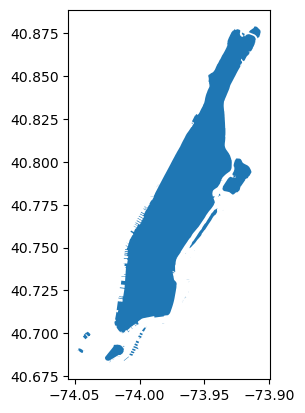

In [5]:
# read and visualize GeoJSON file
import plotly.express as px
import geopandas as gpd
from shapely.geometry import Point
import matplotlib.pyplot as plt

# Load GeoJSON file
geo_data = gpd.read_file('Borough_Boundaries.geojson')

# Filter the GeoDataFrame to only include rows where 'boro_name' is 'Manhattan'
manhattan_boundary = geo_data[geo_data['boro_name'] == 'Manhattan']

# Plot GeoJSON data
manhattan_boundary.plot()
plt.show()

In [6]:
manhattan_boundary.dtypes

boro_code       object
boro_name       object
shape_area      object
shape_leng      object
geometry      geometry
dtype: object

In [7]:
# Get the geometry for Manhattan
manhattan_geometry = manhattan_boundary.geometry.values[0]

# Convert to string
manhattan_geometry_str = str(manhattan_geometry)

# Print the string
print(manhattan_geometry_str)

MULTIPOLYGON (((-74.01092841268026 40.68449147254299, -74.01193259977079 40.68388774915496, -74.01217596614636 40.684095185628514, -74.010116255338 40.6853415982392, -74.0087859013092 40.68614660229894, -74.00869559889541 40.68619331801273, -74.00859803329713 40.68625256408502, -74.00835446532174 40.68640020025073, -74.00816414593905 40.686174717161514, -74.00842516151924 40.68601553244517, -74.0085129425734 40.685962548583724, -74.00860072436832 40.685909564654864, -74.00953293674748 40.68534164804176, -74.01092841268026 40.68449147254299)), ((-74.00500373315074 40.68760598540093, -74.00562986330391 40.68678420554108, -74.00783293766679 40.68738505516279, -74.00742012154092 40.68820629043594, -74.00500373315074 40.68760598540093)), ((-74.00382038919733 40.68892964469937, -74.00459270521766 40.688215222986656, -74.00678438439806 40.6888268799583, -74.00636461225261 40.68966966863701, -74.00382038919733 40.68892964469937)), ((-74.0029756543656 40.69042657592077, -74.00340921624513 40.68

In [8]:
geometry = [Point(xy) for xy in zip(crime_data_2017['Longitude'], crime_data_2017['Latitude'])]

# Convert DataFrame to GeoDataFrame
gdf = gpd.GeoDataFrame(crime_data_2017, geometry=geometry)

# Ensure the GeoDataFrame has the same CRS as the Manhattan boundary data
gdf.set_crs(manhattan_boundary.crs, inplace=True)

,CMPLNT_NUM,CMPLNT_FR_DT,CMPLNT_FR_TM,CMPLNT_TO_DT,CMPLNT_TO_TM,ADDR_PCT_CD,RPT_DT,KY_CD,OFNS_DESC,PD_CD,...,TRANSIT_DISTRICT,Latitude,Longitude,Lat_Lon,PATROL_BORO,STATION_NAME,VIC_AGE_GROUP,VIC_RACE,VIC_SEX,geometry
0,164614602,2017-01-01,00:00:00,05/09/2017,20:47:00,6.0,05/09/2017,109,GRAND LARCENY,407.0,...,NaN,40.733897,-74.005396,"(40.7338967584511, -74.0053958373447)",PATROL BORO MAN SOUTH,(null),UNKNOWN,UNKNOWN,D,POINT (-74.00540 40.73390)
1,160048995,2017-01-07,21:35:00,01/07/2017,21:45:00,23.0,01/07/2017,341,PETIT LARCENY,333.0,...,NaN,40.789463,-73.947634,"(40.7894632995555, -73.9476340039424)",PATROL BORO MAN NORTH,(null),UNKNOWN,UNKNOWN,D,POINT (-73.94763 40.78946)
2,159900502,2017-01-03,16:30:00,NaN,(null),32.0,01/03/2017,351,CRIMINAL MISCHIEF & RELATED OF,259.0,...,NaN,40.815913,-73.945149,"(40.81591307653, -73.9451493066481)",PATROL BORO MAN NORTH,(null),UNKNOWN,UNKNOWN,D,POINT (-73.94515 40.81591)
3,161383959,2017-01-05,13:10:00,01/05/2017,13:15:00,6.0,01/30/2017,109,GRAND LARCENY,425.0,...,NaN,40.733897,-74.005396,"(40.7338967584511, -74.0053958373447)",PATROL BORO MAN SOUTH,(null),25-44,BLACK,M,POINT (-74.00540 40.73390)
4,208633978,2017-01-01,09:00:00,01/28/2020,12:30:00,30.0,01/28/2020,109,GRAND LARCENY,402.0,...,NaN,40.828623,-73.943849,"(40.8286232400477, -73.9438488369889)",PATROL BORO MAN NORTH,(null),25-44,WHITE HISPANIC,M,POINT (-73.94385 40.82862)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
114388,172945872,2017-12-25,15:10:00,12/25/2017,15:13:00,32.0,12/25/2017,105,ROBBERY,386.0,...,NaN,40.815913,-73.945149,"(40.81591307653, -73.9451493066481)",PATROL BORO MAN NORTH,(null),25-44,BLACK,F,POINT (-73.94515 40.81591)
114389,172919903,2017-12-23,17:15:00,12/23/2017,17:45:00,23.0,12/23/2017,235,DANGEROUS DRUGS,511.0,...,NaN,40.789463,-73.947634,"(40.7894632995555, -73.9476340039424)",PATROL BORO MAN NORTH,(null),UNKNOWN,UNKNOWN,E,POINT (-73.94763 40.78946)
114390,177151477,2017-12-26,12:00:00,02/09/2018,11:30:00,17.0,03/30/2018,109,GRAND LARCENY,430.0,...,NaN,40.756820,-73.971143,"(40.7568201683051, -73.9711432633524)",PATROL BORO MAN SOUTH,(null),45-64,WHITE,F,POINT (-73.97114 40.75682)
114391,172948326,2017-12-22,17:00:00,NaN,(null),30.0,12/22/2017,341,PETIT LARCENY,339.0,...,NaN,40.828623,-73.943849,"(40.8286232400477, -73.9438488369889)",PATROL BORO MAN NORTH,(null),45-64,BLACK,M,POINT (-73.94385 40.82862)


In [9]:
# Spatial join
crime_data_2017 = gpd.sjoin(gdf, manhattan_boundary, how="inner", op="within")

crime_data_2017.head()

/Users/conormcelduff/opt/anaconda3/lib/python3.9/site-packages/IPython/core/interactiveshell.py:3448: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if await self.run_code(code, result, async_=asy):


,CMPLNT_NUM,CMPLNT_FR_DT,CMPLNT_FR_TM,CMPLNT_TO_DT,CMPLNT_TO_TM,ADDR_PCT_CD,RPT_DT,KY_CD,OFNS_DESC,PD_CD,...,STATION_NAME,VIC_AGE_GROUP,VIC_RACE,VIC_SEX,geometry,index_right,boro_code,boro_name,shape_area,shape_leng
0,164614602,2017-01-01,00:00:00,05/09/2017,20:47:00,6.0,05/09/2017,109,GRAND LARCENY,407.0,...,(null),UNKNOWN,UNKNOWN,D,POINT (-74.00540 40.73390),3,1,Manhattan,636520502.801,357713.30866
1,160048995,2017-01-07,21:35:00,01/07/2017,21:45:00,23.0,01/07/2017,341,PETIT LARCENY,333.0,...,(null),UNKNOWN,UNKNOWN,D,POINT (-73.94763 40.78946),3,1,Manhattan,636520502.801,357713.30866
2,159900502,2017-01-03,16:30:00,NaN,(null),32.0,01/03/2017,351,CRIMINAL MISCHIEF & RELATED OF,259.0,...,(null),UNKNOWN,UNKNOWN,D,POINT (-73.94515 40.81591),3,1,Manhattan,636520502.801,357713.30866
3,161383959,2017-01-05,13:10:00,01/05/2017,13:15:00,6.0,01/30/2017,109,GRAND LARCENY,425.0,...,(null),25-44,BLACK,M,POINT (-74.00540 40.73390),3,1,Manhattan,636520502.801,357713.30866
4,208633978,2017-01-01,09:00:00,01/28/2020,12:30:00,30.0,01/28/2020,109,GRAND LARCENY,402.0,...,(null),25-44,WHITE HISPANIC,M,POINT (-73.94385 40.82862),3,1,Manhattan,636520502.801,357713.30866


### Filter out indoor crimes

In [10]:
crime_data_2017['PREM_TYP_DESC'].unique()

array(['CHAIN STORE', 'DRUG STORE', 'RESTAURANT/DINER', 'BANK',
       'RESIDENCE - APT. HOUSE', 'PUBLIC BUILDING', 'COMMERCIAL BUILDING',
       'RESIDENCE - PUBLIC HOUSING', 'CLOTHING/BOUTIQUE',
       'TRANSIT - NYC SUBWAY', 'PARKING LOT/GARAGE (PUBLIC)', 'STREET',
       'BAR/NIGHT CLUB', 'DEPARTMENT STORE', 'FAST FOOD',
       'BEAUTY & NAIL SALON', 'STORE UNCLASSIFIED', 'GROCERY/BODEGA',
       'SMALL MERCHANT', 'HOTEL/MOTEL', 'OTHER', 'CHURCH',
       'STORAGE FACILITY', 'PARK/PLAYGROUND', 'DRY CLEANER/LAUNDRY',
       'GYM/FITNESS FACILITY', 'RESIDENCE-HOUSE', 'ABANDONED BUILDING',
       'FOOD SUPERMARKET', 'CHECK CASHING BUSINESS', 'SHOE',
       'BUS TERMINAL', 'HOSPITAL', 'CANDY STORE', 'TUNNEL',
       'TELECOMM. STORE', 'PUBLIC SCHOOL', 'COLLEGE/UNIVERSITY',
       'TAXI (YELLOW LICENSED)', 'VARIETY STORE',
       'PARKING LOT/GARAGE (PRIVATE)', 'REAL ESTATE',
       'PRIVATE/PAROCHIAL SCHOOL', 'BRIDGE', 'DOCTOR/DENTIST OFFICE',
       'SOCIAL CLUB/POLICY', 'JEWELRY', 'CO

In [11]:
outdoor_features = ['STREET', 'PARKING LOT/GARAGE (PUBLIC)', 'PARK/PLAYGROUND', 
                    'ABANDONED BUILDING', 'BUS TERMINAL', 'BRIDGE', 'CONSTRUCTION SITE',
                    'HIGHWAY/PARKWAY', 'MARINA/PIER', 'BUS STOP', 'GAS STATION',
                    'OPEN AREAS (OPEN LOTS)', 'TRANSIT FACILITY (OTHER)', 
                    'FERRY/FERRY TERMINAL', 'FACTORY/WAREHOUSE', 'TRAMWAY',
                    'CEMETERY', 'AIRPORT TERMINAL']

In [12]:
# and outdoor_features is either a list or a numpy array

crime_data_2017_outdoors = crime_data_2017[crime_data_2017['PREM_TYP_DESC'].isin(outdoor_features)]

In [13]:
crime_data_2017_outdoors.shape

(31245, 41)

In [14]:
crime_data_2017_extracted = crime_data_2017_outdoors[['CMPLNT_FR_DT', 'CMPLNT_FR_TM', 'Latitude', 'Longitude']]

In [15]:
crime_data_2017_extracted.dtypes

CMPLNT_FR_DT     object
CMPLNT_FR_TM     object
Latitude        float64
Longitude       float64
dtype: object

In [16]:
crime_data_2017_extracted.head(3)

,CMPLNT_FR_DT,CMPLNT_FR_TM,Latitude,Longitude
21,2017-01-01,03:00:00,40.737203,-73.983273
24,2017-01-06,22:45:00,40.800930,-73.941098
32,2017-01-01,02:00:00,40.765024,-73.984836


# Data preprocessing:

In [17]:
# Check for missing values
print(crime_data_2017_extracted.isnull().sum())

CMPLNT_FR_DT    0
CMPLNT_FR_TM    0
Latitude        0
Longitude       0
dtype: int64


In [18]:
# Convert date and time to datetime object and extract relevant features
crime_data_2017_extracted['CMPLNT_FR_DT'] = pd.to_datetime(crime_data_2017_extracted['CMPLNT_FR_DT'])
crime_data_2017_extracted['CMPLNT_FR_TM'] = pd.to_datetime(crime_data_2017_extracted['CMPLNT_FR_TM'], format='%H:%M:%S').dt.time

# Extract the hour from the time
crime_data_2017_extracted['Hour'] = crime_data_2017_extracted['CMPLNT_FR_TM'].apply(lambda x: x.hour)

# Extract the day of week from the date (Monday=0, Sunday=6)
crime_data_2017_extracted['DayOfWeek'] = crime_data_2017_extracted['CMPLNT_FR_DT'].dt.dayofweek

# Extract the month from the date
crime_data_2017_extracted['Month'] = crime_data_2017_extracted['CMPLNT_FR_DT'].dt.month

/var/folders/fq/bzr8_90x2fz7g47x1rk7l_tm0000gn/T/ipykernel_20597/1551153485.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  crime_data_2017_extracted['CMPLNT_FR_DT'] = pd.to_datetime(crime_data_2017_extracted['CMPLNT_FR_DT'])
/var/folders/fq/bzr8_90x2fz7g47x1rk7l_tm0000gn/T/ipykernel_20597/1551153485.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  crime_data_2017_extracted['CMPLNT_FR_TM'] = pd.to_datetime(crime_data_2017_extracted['CMPLNT_FR_TM'], format='%H:%M:%S').dt.time
/var/folders/fq/bzr8_90x2

In [19]:
crime_data_2017_extracted.head(3)

,CMPLNT_FR_DT,CMPLNT_FR_TM,Latitude,Longitude,Hour,DayOfWeek,Month
21,2017-01-01,03:00:00,40.737203,-73.983273,3,6,1
24,2017-01-06,22:45:00,40.800930,-73.941098,22,4,1
32,2017-01-01,02:00:00,40.765024,-73.984836,2,6,1


In [20]:
# Specify the country and the year
us_holidays = holidays.UnitedStates(years=2017)

# Create 'isHoliday' column
crime_data_2017_extracted['isHoliday'] = crime_data_2017_extracted['CMPLNT_FR_DT'].apply(lambda x: int(x in us_holidays))

/var/folders/fq/bzr8_90x2fz7g47x1rk7l_tm0000gn/T/ipykernel_20597/3949318115.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  crime_data_2017_extracted['isHoliday'] = crime_data_2017_extracted['CMPLNT_FR_DT'].apply(lambda x: int(x in us_holidays))


In [21]:
print(type(us_holidays))

<class 'holidays.countries.united_states.UnitedStates'>


In [22]:
print(us_holidays)

{datetime.date(2017, 1, 16): 'Martin Luther King Jr. Day', datetime.date(2017, 2, 20): "Washington's Birthday", datetime.date(2017, 10, 9): 'Columbus Day', datetime.date(2017, 1, 1): "New Year's Day", datetime.date(2017, 1, 2): "New Year's Day (Observed)", datetime.date(2017, 5, 29): 'Memorial Day', datetime.date(2017, 7, 4): 'Independence Day', datetime.date(2017, 9, 4): 'Labor Day', datetime.date(2017, 11, 11): 'Veterans Day', datetime.date(2017, 11, 10): 'Veterans Day (Observed)', datetime.date(2017, 11, 23): 'Thanksgiving', datetime.date(2017, 12, 25): 'Christmas Day'}


In [23]:
us_holidays

{datetime.date(2017, 1, 16): 'Martin Luther King Jr. Day', datetime.date(2017, 2, 20): "Washington's Birthday", datetime.date(2017, 10, 9): 'Columbus Day', datetime.date(2017, 1, 1): "New Year's Day", datetime.date(2017, 1, 2): "New Year's Day (Observed)", datetime.date(2017, 5, 29): 'Memorial Day', datetime.date(2017, 7, 4): 'Independence Day', datetime.date(2017, 9, 4): 'Labor Day', datetime.date(2017, 11, 11): 'Veterans Day', datetime.date(2017, 11, 10): 'Veterans Day (Observed)', datetime.date(2017, 11, 23): 'Thanksgiving', datetime.date(2017, 12, 25): 'Christmas Day'}

In [24]:
crime_data_2017_extracted['isWeekend'] = crime_data_2017_extracted['DayOfWeek'].isin([5, 6]).astype(int)

/var/folders/fq/bzr8_90x2fz7g47x1rk7l_tm0000gn/T/ipykernel_20597/3063634919.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  crime_data_2017_extracted['isWeekend'] = crime_data_2017_extracted['DayOfWeek'].isin([5, 6]).astype(int)


In [25]:
crime_data_2017_extracted.head(3)

,CMPLNT_FR_DT,CMPLNT_FR_TM,Latitude,Longitude,Hour,DayOfWeek,Month,isHoliday,isWeekend
21,2017-01-01,03:00:00,40.737203,-73.983273,3,6,1,1,1
24,2017-01-06,22:45:00,40.800930,-73.941098,22,4,1,0,0
32,2017-01-01,02:00:00,40.765024,-73.984836,2,6,1,1,1


In [26]:
crime_data_2017_extracted.shape

(31245, 9)

In [27]:
crime_data_2017_extracted.dtypes

CMPLNT_FR_DT    datetime64[ns]
CMPLNT_FR_TM            object
Latitude               float64
Longitude              float64
Hour                     int64
DayOfWeek                int32
Month                    int32
isHoliday                int64
isWeekend                int64
dtype: object

In [28]:
crime_data_2017_extracted.head(3)

,CMPLNT_FR_DT,CMPLNT_FR_TM,Latitude,Longitude,Hour,DayOfWeek,Month,isHoliday,isWeekend
21,2017-01-01,03:00:00,40.737203,-73.983273,3,6,1,1,1
24,2017-01-06,22:45:00,40.800930,-73.941098,22,4,1,0,0
32,2017-01-01,02:00:00,40.765024,-73.984836,2,6,1,1,1


In [29]:
# Descriptive statistics
print(crime_data_2017_extracted.describe())

                        CMPLNT_FR_DT      Latitude     Longitude  \
count                          31245  31245.000000  31245.000000   
mean   2017-07-07 22:14:35.890542336     40.775655    -73.970386   
min              2017-01-01 00:00:00     40.716012    -74.008078   
25%              2017-04-21 00:00:00     40.737203    -73.994537   
50%              2017-07-12 00:00:00     40.766996    -73.974898   
75%              2017-09-28 00:00:00     40.808418    -73.945149   
max              2017-12-31 00:00:00     40.861107    -73.921364   
std                              NaN      0.041955      0.024115   

               Hour     DayOfWeek         Month     isHoliday     isWeekend  
count  31245.000000  31245.000000  31245.000000  31245.000000  31245.000000  
mean      12.987678      3.097104      6.727956      0.026692      0.288910  
min        0.000000      0.000000      1.000000      0.000000      0.000000  
25%        8.000000      1.000000      4.000000      0.000000      0.000000

In [30]:
# Checking for missing values
print(crime_data_2017_extracted.isnull().sum())

CMPLNT_FR_DT    0
CMPLNT_FR_TM    0
Latitude        0
Longitude       0
Hour            0
DayOfWeek       0
Month           0
isHoliday       0
isWeekend       0
dtype: int64


<Axes: xlabel='DayOfWeek'>

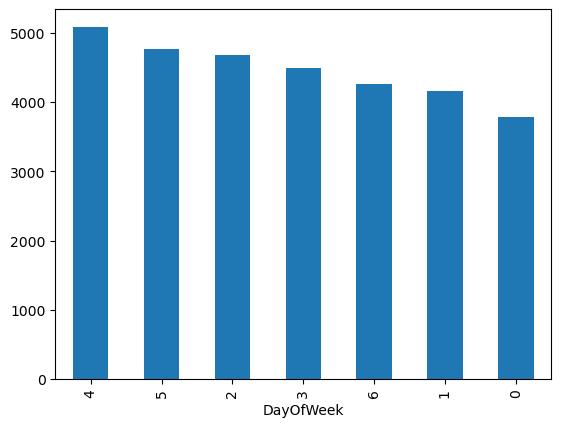

In [31]:
# Count of crimes by DayOfWeek
crime_data_2017_extracted['DayOfWeek'].value_counts().plot(kind='bar')

<Axes: xlabel='Month'>

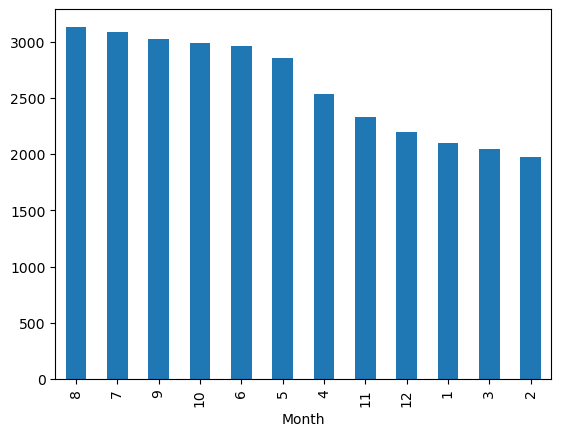

In [32]:
# Count of crimes by month
crime_data_2017_extracted['Month'].value_counts().plot(kind='bar')

<Axes: xlabel='isHoliday'>

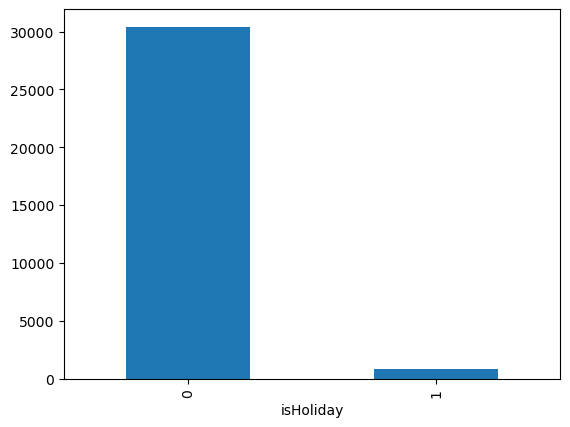

In [33]:
# Count of crimes by month
crime_data_2017_extracted['isHoliday'].value_counts().plot(kind='bar')

<Axes: >

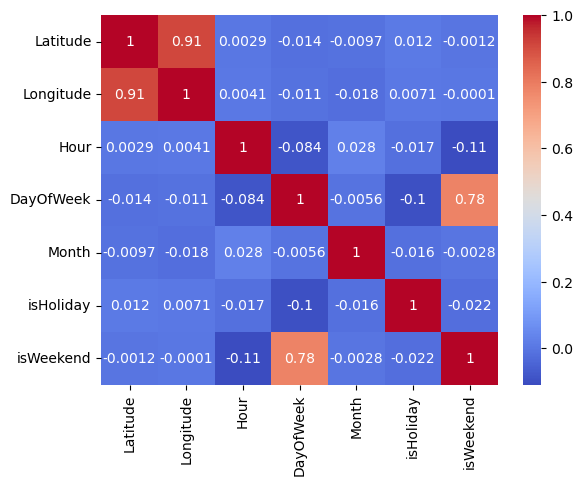

In [34]:
# Heatmap of correlations among features
import seaborn as sns
import numpy as np
numeric_data = crime_data_2017_extracted.select_dtypes(include=[np.number])
sns.heatmap(numeric_data.corr(), annot=True, cmap='coolwarm')

In [35]:
crime_data_2017_extracted.head(3)

,CMPLNT_FR_DT,CMPLNT_FR_TM,Latitude,Longitude,Hour,DayOfWeek,Month,isHoliday,isWeekend
21,2017-01-01,03:00:00,40.737203,-73.983273,3,6,1,1,1
24,2017-01-06,22:45:00,40.800930,-73.941098,22,4,1,0,0
32,2017-01-01,02:00:00,40.765024,-73.984836,2,6,1,1,1


# Modeling

# K-Means Clustering

In [36]:
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler

# Specify your feature columns
feature_cols = ['Latitude', 'Longitude', 'Hour', 'DayOfWeek', 'Month']

# X is the DataFrame with your features
X = crime_data_2017_extracted[feature_cols]

# It could be beneficial to standardize your data for clustering
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Apply KMeans clustering
# The number of clusters (n_clusters) is a parameter you might need to adjust based on your data
kmeans = KMeans(n_clusters=500, random_state=42)
kmeans.fit(X_scaled)

# The cluster assignments are stored in kmeans.labels_
clusters = kmeans.labels_


crime_data_2017_extracted['Cluster'] = clusters

/Users/conormcelduff/opt/anaconda3/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/var/folders/fq/bzr8_90x2fz7g47x1rk7l_tm0000gn/T/ipykernel_20597/1433822120.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  crime_data_2017_extracted['Cluster'] = clusters


# OPTICS clustering

In [37]:
# from sklearn.cluster import OPTICS
# from sklearn.preprocessing import StandardScaler

# # Specify your feature columns
# feature_cols = ['Latitude', 'Longitude', 'Hour', 'DayOfWeek', 'Month']

# # X is the DataFrame with your features
# X = crime_data_2017_extracted[feature_cols]

# # It could be beneficial to standardize your data for clustering
# scaler = StandardScaler()
# X_scaled = scaler.fit_transform(X)

# # Apply OPTICS clustering
# optics = OPTICS(min_samples=5) # you might need to adjust these parameters based on your data
# optics.fit(X_scaled)

# # The cluster assignments are stored in optics.labels_
# clusters = optics.labels_


In [38]:
import numpy as np

# Calculate the number of clusters
n_clusters = len(np.unique(clusters)) - (1 if -1 in clusters else 0)
print('Number of clusters: {}'.format(n_clusters))

Number of clusters: 500


In [39]:
import folium
import matplotlib
import matplotlib.cm as cm

# Initialize the map centered around the middle of Manhattan
m = folium.Map(location=[40.7831, -73.9712], tiles='Stamen Toner', zoom_start=12)

# Generate a color palette
color_palette = cm.get_cmap('Set3', n_clusters)
color_dict = {label: color_palette(idx) for idx, label in enumerate(np.unique(clusters))}

# Add a marker for each crime event, colored by cluster
for lat, lon, cluster in zip(crime_data_2017_extracted['Latitude'], 
                             crime_data_2017_extracted['Longitude'], 
                             clusters):
    if cluster == -1: # noise
        color = 'green'
    else:
        color = matplotlib.colors.rgb2hex(color_dict[cluster])
    
    folium.CircleMarker([lat, lon],
                        radius=5,
                        color=color,
                        fill=True,
                        fill_color=color,
                        fill_opacity=0.7).add_to(m)

# Display the map
m


/var/folders/fq/bzr8_90x2fz7g47x1rk7l_tm0000gn/T/ipykernel_20597/522369352.py:9: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  color_palette = cm.get_cmap('Set3', n_clusters)


In [40]:
# Add cluster labels to the data
crime_data_2017_extracted['Cluster'] = clusters

/var/folders/fq/bzr8_90x2fz7g47x1rk7l_tm0000gn/T/ipykernel_20597/2486819309.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  crime_data_2017_extracted['Cluster'] = clusters


In [41]:
crime_data_2017_extracted.head()

,CMPLNT_FR_DT,CMPLNT_FR_TM,Latitude,Longitude,Hour,DayOfWeek,Month,isHoliday,isWeekend,Cluster
21,2017-01-01,03:00:00,40.737203,-73.983273,3,6,1,1,1,20
24,2017-01-06,22:45:00,40.800930,-73.941098,22,4,1,0,0,307
32,2017-01-01,02:00:00,40.765024,-73.984836,2,6,1,1,1,364
40,2017-01-03,20:50:00,40.828623,-73.943849,20,1,1,0,0,33
55,2017-01-07,22:00:00,40.851213,-73.935216,22,5,1,0,1,413


In [42]:
# Count the number of occurrences for each unique combination of 'Cluster', 'Hour', 'DayOfWeek', and 'isWeekend'
crime_counts = crime_data_2017_extracted.groupby(['Cluster', 'Hour', 'DayOfWeek','Month']).size().reset_index(name='CrimeCount')

# Merge this with the original DataFrame
crime_data_2017_extracted = crime_data_2017_extracted.merge(crime_counts, on=['Month','Cluster', 'Hour', 'DayOfWeek'], how='left')

In [43]:
crime_data_2017_extracted.head(3)

,CMPLNT_FR_DT,CMPLNT_FR_TM,Latitude,Longitude,Hour,DayOfWeek,Month,isHoliday,isWeekend,Cluster,CrimeCount
0,2017-01-01,03:00:00,40.737203,-73.983273,3,6,1,1,1,20,8
1,2017-01-06,22:45:00,40.800930,-73.941098,22,4,1,0,0,307,3
2,2017-01-01,02:00:00,40.765024,-73.984836,2,6,1,1,1,364,5


In [44]:
crime_count = crime_data_2017_extracted['CrimeCount']

# basic statistics
print(crime_count.describe())

count    31245.000000
mean         4.189438
std          2.956041
min          1.000000
25%          2.000000
50%          4.000000
75%          5.000000
max         27.000000
Name: CrimeCount, dtype: float64


## Create binning values 

In [45]:
crime_data_2017_extracted['CrimeCount_binned'] = pd.qcut(crime_data_2017_extracted['CrimeCount'], q=18, labels=False, duplicates='drop')

In [46]:
test = crime_data_2017_extracted['CrimeCount_binned']

## Test value counts for binning values

### More variation with binning values when we avoid using the month groupby feature value 

In [47]:
test.value_counts()

CrimeCount_binned
0    9748
1    5715
2    4796
3    3630
4    2460
7    1663
5    1638
6    1595
Name: count, dtype: int64

This can happen if there are significant amount of repeated values in the dataset that limit the number of unique quantile-based cuts/bins that can be created. 

In [48]:
crime_data_2017_extracted.head(3)

,CMPLNT_FR_DT,CMPLNT_FR_TM,Latitude,Longitude,Hour,DayOfWeek,Month,isHoliday,isWeekend,Cluster,CrimeCount,CrimeCount_binned
0,2017-01-01,03:00:00,40.737203,-73.983273,3,6,1,1,1,20,8,6
1,2017-01-06,22:45:00,40.800930,-73.941098,22,4,1,0,0,307,3,1
2,2017-01-01,02:00:00,40.765024,-73.984836,2,6,1,1,1,364,5,3


In [49]:
# # Select only the Latitude and Longitude columns
# location_data = crime_data_2017_extracted[['Latitude', 'Longitude']]

# # Export to a CSV file
# location_data.to_csv('location_data.csv', index=False)

In [50]:
crime_data = crime_data_2017_extracted

In [51]:
crime_data

,CMPLNT_FR_DT,CMPLNT_FR_TM,Latitude,Longitude,Hour,DayOfWeek,Month,isHoliday,isWeekend,Cluster,CrimeCount,CrimeCount_binned
0,2017-01-01,03:00:00,40.737203,-73.983273,3,6,1,1,1,20,8,6
1,2017-01-06,22:45:00,40.800930,-73.941098,22,4,1,0,0,307,3,1
2,2017-01-01,02:00:00,40.765024,-73.984836,2,6,1,1,1,364,5,3
3,2017-01-03,20:50:00,40.828623,-73.943849,20,1,1,0,0,33,7,5
4,2017-01-07,22:00:00,40.851213,-73.935216,22,5,1,0,1,413,2,0
...,...,...,...,...,...,...,...,...,...,...,...,...
31240,2017-12-27,17:00:00,40.840781,-73.936245,17,2,12,0,0,445,6,4
31241,2017-12-28,22:10:00,40.737203,-73.983273,22,3,12,0,0,451,3,1
31242,2017-12-25,15:10:00,40.815913,-73.945149,15,0,12,1,0,222,3,1
31243,2017-12-22,17:00:00,40.828623,-73.943849,17,4,12,0,0,81,16,7


In [52]:
crime_data = crime_data.drop(columns=["CMPLNT_FR_DT","CMPLNT_FR_TM","isHoliday","isWeekend"])

In [53]:
crime_data

,Latitude,Longitude,Hour,DayOfWeek,Month,Cluster,CrimeCount,CrimeCount_binned
0,40.737203,-73.983273,3,6,1,20,8,6
1,40.800930,-73.941098,22,4,1,307,3,1
2,40.765024,-73.984836,2,6,1,364,5,3
3,40.828623,-73.943849,20,1,1,33,7,5
4,40.851213,-73.935216,22,5,1,413,2,0
...,...,...,...,...,...,...,...,...
31240,40.840781,-73.936245,17,2,12,445,6,4
31241,40.737203,-73.983273,22,3,12,451,3,1
31242,40.815913,-73.945149,15,0,12,222,3,1
31243,40.828623,-73.943849,17,4,12,81,16,7


In [54]:
crime_data['CrimeCount_binned_regression'] = crime_data['CrimeCount_binned'] / 15
crime_data

,Latitude,Longitude,Hour,DayOfWeek,Month,Cluster,CrimeCount,CrimeCount_binned,CrimeCount_binned_regression
0,40.737203,-73.983273,3,6,1,20,8,6,0.400000
1,40.800930,-73.941098,22,4,1,307,3,1,0.066667
2,40.765024,-73.984836,2,6,1,364,5,3,0.200000
3,40.828623,-73.943849,20,1,1,33,7,5,0.333333
4,40.851213,-73.935216,22,5,1,413,2,0,0.000000
...,...,...,...,...,...,...,...,...,...
31240,40.840781,-73.936245,17,2,12,445,6,4,0.266667
31241,40.737203,-73.983273,22,3,12,451,3,1,0.066667
31242,40.815913,-73.945149,15,0,12,222,3,1,0.066667
31243,40.828623,-73.943849,17,4,12,81,16,7,0.466667


In [55]:
crime_data = crime_data.drop(columns=["CrimeCount","CrimeCount_binned"])

In [56]:
crime_data.to_csv("Crime_Data_Model_Month.csv")